<a href="https://colab.research.google.com/github/BedinEduardo/Colab_Repositories/blob/master/PyTorch_DCGAN_Tutorial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

 # DCGAN Tutorial

 ## Introduction

 This tutorial will give an introduction to DCGANs trough an example.
 Will train a GAN to generate new celebrities after showing pictures of many real celebrities.

 ## Generative Adversarial Networks
 ### What is a GAN?

 GANs are a framework for teaching a DL model to capture the training data distribution so we can generate new data from that some distribution.
 They are made from two distincts models, a *generator* and a *discrimintor*.
 The job of the *generator* is to spawn 'fake' images that look like the training images.
 The job of the discriminator is to look at an image and output whether or not it is a real training image or a fake image from the generator.
 The equilibrium of this game is when the generator is generating perfects fakes that look as if they came directly from the training data, and the discriminator is left to always guess 50% confidence that the generator ouput is real or fake.

 Now lets define some notation to be used throughout tutorial starting with the discriminator.

 ### What is a DCGAN?

 A DCGAN is a direct extension of the GAN described above, except that it explicity used convolutional and convolutional transpose layers in the discriminator and generator, respectivelly.
 The discriminator is made up of strided convolution layers, and LeakyReKU activations.
 The generator is comprised of convolutional transpose layers, batch norm layers, and ReLU activations.

In [ ]:
# matplotlib in line
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [ ]:
# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000)  # use if you want new results
print(f"Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True)  # Needed for reproducible results

Random Seed:  999


## Inputs

Let's define some inputs for the run:

* `dataroot`: the path to the root of the dataset folder. We will talk more about the dataset in the next section.
* `workers`: the number of workers threads for loafing the data with the `DataLoader`.
* `batch_size`: the batch size used in training. The DCGAN paper uses a batch size of 128.
* `image_size` - the spatial size of the images used for training. This implementation defaults 64x64. If another size is desired, the structures od D and G must be changed.
* `nc` - number of color channels in the input image. Color images this is 3.
* `nz` - lenght of latent vector
* `ngf` - relates to the depth of feature maps carried through the generator
* `ndf` - sets the depth of feature maps propagated through the discriminator.
* `num_epochs` - number of training epochs to run.
* `lr` - learning rate for training. As described in the DCGAN paper, this number should be 0.0002
* `beta1` - beta 1 hyperparameter for Adam optimnizers. As described in paperm this number should be 0.5.
* `ngpu` - number of GPUs available. If this is 0, code will run in CPU mode.


In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("jessicali9530/celeba-dataset")

print("Path to dataset files:", path)


Path to dataset files: /kaggle/input/celeba-dataset


In [ ]:
# Root directory for dataset
dataroot = path

# number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All image will be resized to this size using transformers
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# size of z latent vector (i.e size of generator input)
nz = 100

# size of feature maps in generator
ngf = 64

# size of feature maps in discriminator
ndf = 64

# number of training epochs
num_epochs = 5

# learning rate for optimizers
lr = 0.0002
# beta1 hypereparameter for Adam optimizers
beta1 = 0.5

# Number of  GPUs available. Use  0 for CPU mode
ngpu =1

## Data

**Celeb-A Faces dataset.

In [ ]:
# import kagglehub

# # Download latest version
# path = kagglehub.dataset_download("jessicali9530/celeba-dataset")

# print("Path to dataset files:", path)


In [ ]:
# we can use an image folder dataset the way we have it setup
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
                           ]))

In [ ]:
# Build the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

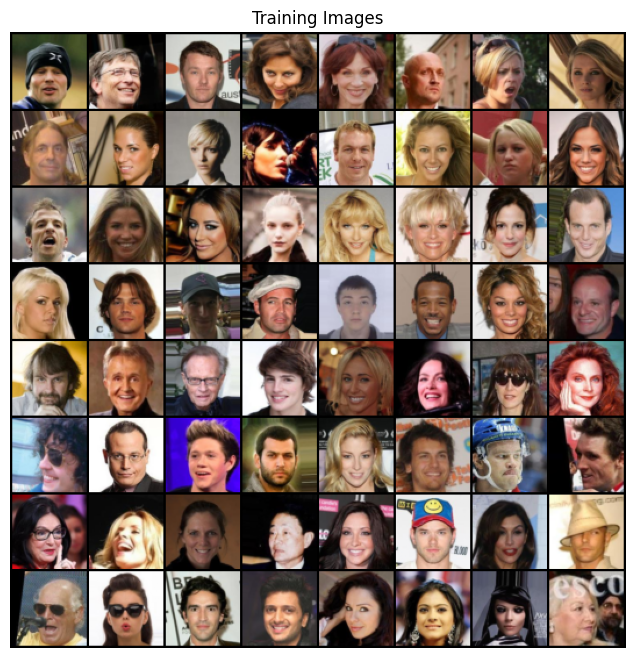

In [ ]:
# device which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

## Implementation

With our input parameters ser and dataset prepared, we can now get into the implementation strategy.

## Weight initialization

From the DCGAN paper, the authors specify that all model weights be randomly initialized from a Normal distribution with `mean=0`, `stdev=0.2`. The `weights_init` function takes an initialized model as input and reinitializes all convolutional, convolutional-transpose, and batch normalization layers to meet this criteria.

In [ ]:
# custom weights initialization called on `netG` and `netD`
def weights_init(m):
  classname = m.__class__.__name__
  if classname.find('Conv') != -1:
    nn.init.normal_(m.weight.data, 0.0, 0.02)
  elif classname.find('BatchNorm') != -1:
    nn.init.normal_(m.weight.data, 1.0, 0.02)
    nn.init.constant_(m.bias.data, 0)


## Generator

The generator, *G*, is designed to map the latent space vecotor (*z*) to data-space.
Since our data are images, converting *z* to data-space means ultimately building a RGB image with the same size as the training images (3x64x64).
A series of strided two dimensional convolutional transpose layers, each paired with a 2d batch norm layer and a relu activation.

In [ ]:
# Generator Code
class Generator(nn.Module):
  def __init__(self, ngpu):
    super(Generator, self).__init__()
    self.ngpu = ngpu
    self.main = nn.Sequential(
        # input is Z, going to a convolution
        nn.ConvTranspose2d(nz, ngf *8,4,1,0, bias=False),
        nn.BatchNorm2d(ngf * 8),
        nn.ReLU(True),
        # State size. ''(ngf*8) x 4 x4
        nn.ConvTranspose2d(ngf *8, ngf *4,4,2,1, bias=False),
        nn.BatchNorm2d(ngf *4),
        nn.ReLU(True),
        # State size ''(ngf*4) x8x8
        nn.ConvTranspose2d(ngf *4, ngf *2,4,2,1, bias=False),
        nn.BatchNorm2d(ngf *2),
        nn.ReLU(True),
        # state size. ``(ngf*2) x 16 x 16``
        nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ngf),
        nn.ReLU(True),
        # state size. ``(ngf) x 32 x 32``
        nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
        nn.Tanh()
        # state size `(nc) x 64 x 64`
    )

  def forward(self, input):
    return self.main(input)

In [ ]:
# Build the Generator
netG = Generator(ngpu).to(device)


In [ ]:
# Handle multi GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
  netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the `weights_init` function to randomly initialize all weights
# to `mean=0`, `stdev=0.02`
netG.apply(weights_init)

print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


## Discriminator

As mentioned, the discriminator, *D*, is a binary classification network that takes an image as input and outputs a scalar probability that the input image is real.

This architecture can be  extended with more layers if necessary for the problem, but is significance to the use of the stridded convolution, BatchNorn, and LeakyReLU.

In [ ]:
class Discriminator(nn.Module):
  def __init__(self, ngpu):
    super(Discriminator, self).__init__()
    self.ngpu = ngpu
    self.main = nn.Sequential(
        # input is `(nc) x 64 x 64`
        nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
        nn.LeakyReLU(0.2, inplace=True),
        # state size `(ndf) x 32 x 32`
        nn.Conv2d(ndf, ndf *2, 4,2,1, bias = False),
        nn.BatchNorm2d(ndf *2),
        nn.LeakyReLU(0.2, inplace=True),
        # state size `(ndf*2) x 16 x 16
        nn.Conv2d(ndf *2, ndf *4,4,2,1, bias=False),
        nn.BatchNorm2d(ndf *4),
        nn.LeakyReLU(0.2, inplace=True),
        # state size (ndf*4) * 8 * 8
        nn.Conv2d(ndf *4, ndf *8,4,2,1, bias=False),
        nn.BatchNorm2d(ndf *8),
        nn.LeakyReLU(0.2, inplace=True),
        # state size (ndf*8) *4*4
        nn.Conv2d(ndf *8,1,4,1,0, bias=False),
        nn.Sigmoid()
    )
  def forward(self, input):
    return self.main(input)

Now,as with the generator we can build the discriminator, apply the `weights_init` function, and print the model's structure

In [ ]:
# Build the Discriminator
netD =Discriminator(ngpu).to(device)

# Handle multi-GPU if desidered
if (device.type =='cuda') and (ngpu >1):
  netD = nn.DataParallel(netD, list(range(ngpu)))

# apply the `weights_init` function to randomly initialize all weights
# like this: `to mean=0, stdev=0.2`
netD.apply(weights_init)

# print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Loss Functions and Optmizers

With *D* and *G* setup, we can specify how they learn trhough the loss functions and optimizers. Binary Cross Entropy loss (ECELoss)

In [ ]:
# Initialize the `BCELoss` function
criterion = nn.BCELoss()

# Build batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(64, nz, 1,1, device=device)

# Establish convention for real and fake labels during training
real_label =1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))

## Training

Be mindful that training GANs is somewhat of an art from, as incorrect hyperparameter settings lead to mode collapse with little explanation of what went wrong.

**Part 1 - Train the Discriminator**

Recall, the goal of training the discriminator is to maximize the probability of correctly classifying a given inputs as real or fake.
It is calculated in two steps.
Firts construct a batch of real samples from the training set, forward pass through *D*, calculate the loss, then calculate the gradients in a backward pass.
Secondly, construct a batch od fake samples with the current generator, forward pass this batch trough *D*, calculate the loss, and accumulate the gradients with a backward pass.

**Part 2- Train the Geenrator**

As tested in the original paper, we want to train the Generator by minimizing loss in an effort to generate better fakes.

The train statistics are:

* **Loss_D**: Discriminator loss calculated as the sum of losses for the all fake batches.
* **Loss_G**: Generator loss calculated as l
* **D(X)** - the average output - accross the batch. This should start close to 1 then theorically converge to 0.5 when G gets better.
* **D(G(Z))**- Averga discriminator outputs for all fake batch. The first number is before D is updated and the second number is after D is updated.. These numbers shoul start near 0 and converge to 0.5 as G gets better.

In [ ]:
# training loop
# lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("starting training loop")

for epoch in range(num_epochs):
  # for each bathc in the dataloader
  for i, data in enumerate(dataloader, 0):
    # (1) Update D network: maximize log(D(x)) + log(1 -D(G(z)))
    # train with all-real batch
    netD.zero_grad()
    # format batch
    real_cpu = data[0].to(device)
    b_size = real_cpu.size(0)
    label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
    # forward pass real batch through D
    output = netD(real_cpu).view(-1)
    # calculate the loss on all-real batch
    errD_real = criterion(output, label)
    # calculate gradients for D in backward pass
    errD_real.backward()
    D_x = output.mean().item()

    # Train with all-fake batch
    # generate batch of latent vectors
    noise = torch.randn(b_size, nz, 1,1, device=device)
    # Generate fake image batch with G
    fake = netG(noise)
    label.fill_(fake_label)
    # classify all fakke batch with D
    output = netD(fake.detach()).view(-1)
    # calcualte D's loss on the all fake batch
    errD_fake = criterion(output, label)
    # calculate the gradients for this batch, accumulated (summed) with previous gradients
    errD_fake.backward()
    D_G_z1 = output.mean().item()
    # compute error of D as sum over the fake and the real batches
    errD = errD_real + errD_fake
    optimizerD.step()

    # (2) Update G-Network: maximnize log(D(G(z)))
    netG.zero_grad()
    label.fill_(real_label)  # fakes labels are real for generator cost
    # since we just updated D, perform another forward pass of all-fake batch trough D
    output = netD(fake).view(-1)
    # calculate gradients for G
    errG = criterion(output, label)
    errG.backward()
    D_G_z2 = output.mean().item()
    # update G
    optimizerG.step()

    # output training stats- Continue from here
    if i % 50 == 0:
      print(f'[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'  % (epoch, num_epochs, i, len(dataloader), errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

    # Save Losses for plotting later
    G_losses.append(errG.item())
    D_losses.append(errD.item())

    # Check how the generator is doing by saving G's output on fixed_noise
    if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
      with torch.no_grad():
        fake = netG(fixed_noise).detach().cpu()
      img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

    iters += 1



starting training loop
[0/5][0/1583]	Loss_D: 1.2337	Loss_G: 5.8246	D(x): 0.9985	D(G(z)): 0.6276 / 0.0065
[0/5][50/1583]	Loss_D: 0.5507	Loss_G: 3.7494	D(x): 0.9942	D(G(z)): 0.4011 / 0.0267
[0/5][100/1583]	Loss_D: 0.5385	Loss_G: 3.1725	D(x): 0.9967	D(G(z)): 0.3996 / 0.0455
[0/5][150/1583]	Loss_D: 0.5428	Loss_G: 2.8779	D(x): 0.9973	D(G(z)): 0.4045 / 0.0604
[0/5][200/1583]	Loss_D: 0.5337	Loss_G: 2.6395	D(x): 0.9971	D(G(z)): 0.4024 / 0.0754
[0/5][250/1583]	Loss_D: 0.4872	Loss_G: 2.5779	D(x): 0.9978	D(G(z)): 0.3754 / 0.0801
[0/5][300/1583]	Loss_D: 0.5030	Loss_G: 2.4777	D(x): 0.9979	D(G(z)): 0.3862 / 0.0886
[0/5][350/1583]	Loss_D: 0.4940	Loss_G: 2.3704	D(x): 0.9976	D(G(z)): 0.3819 / 0.0973
[0/5][400/1583]	Loss_D: 0.4719	Loss_G: 2.3447	D(x): 0.9980	D(G(z)): 0.3692 / 0.1009
[0/5][450/1583]	Loss_D: 0.4695	Loss_G: 2.2055	D(x): 0.9989	D(G(z)): 0.3686 / 0.1154
[0/5][500/1583]	Loss_D: 0.4715	Loss_G: 2.0408	D(x): 0.9990	D(G(z)): 0.3693 / 0.1367
[0/5][550/1583]	Loss_D: 0.4493	Loss_G: 1.8321	D(x): 0.99

## Results

Finally. lets check out how we did.
Here, will look at three differents results.

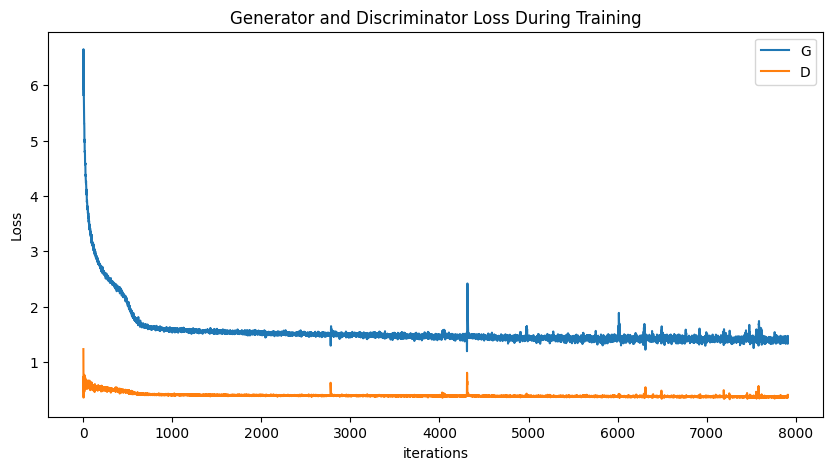

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

### Visualization of G's progression

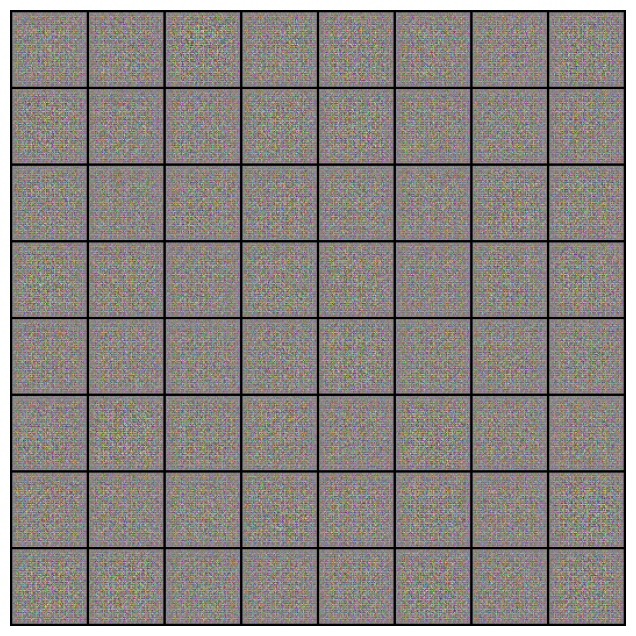

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

### Real Image vs Fake Images

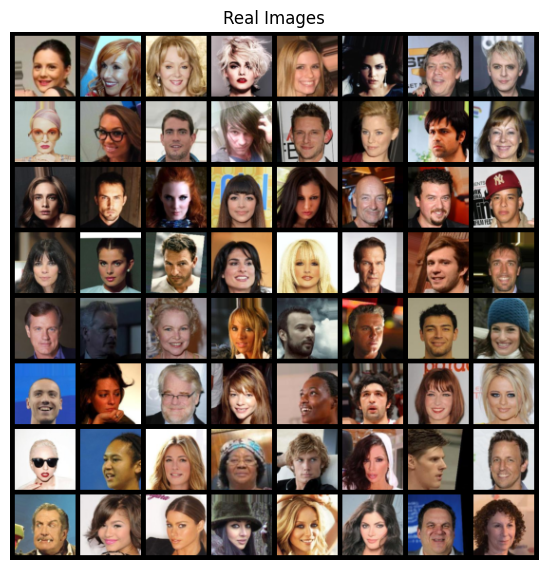

In [ ]:
# grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

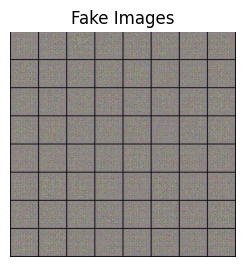

In [ ]:
#plot the fakes images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()